# The Future is Now: Patterns in Global Temperature Trends Across the World

Continued from `Analysis 4.ipynb`.

## Dependency Installation & Imports

In [1]:
%pip install pandas numpy scikit-learn matplotlib missingno pyarrow pycountry_convert kgcpy scipy folium

Note: you may need to restart the kernel to use updated packages.


In [2]:
import folium
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

In [3]:
global_correlation = 0.895059831369191

In [4]:
with open('Data_kmeans.csv', 'r', encoding='utf-8') as file:
    df_kmeans = pd.read_csv(file, encoding='utf-8')

with open('Data_hierarchical.csv', 'r', encoding='utf-8') as file:
    df_hierarchical = pd.read_csv(file, encoding='utf-8')
    
with open('Data_gmm.csv', 'r', encoding='utf-8') as file:
    df_gmm = pd.read_csv(file, encoding='utf-8')
    
with open('Data_augmented.csv', 'r', encoding='utf-8') as file:
    df = pd.read_csv(file, encoding='utf-8')

In [5]:
corr_df = df.groupby(['City', 'Country']).apply(
    lambda x: x['AverageTemperature'].corr(x['Year'])
).reset_index(name='corr')

C:\Users\jacob\AppData\Local\Temp\ipykernel_472\4136194125.py:1: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  corr_df = df.groupby(['City', 'Country']).apply(


In [6]:
def map_corr_to_df(target_df, corr_df):
    # Merge on City and Country to bring in the corr values
    merged_df = pd.merge(target_df, corr_df, on=['City', 'Country'], how='left')
    merged_df.rename(columns={'corr': 'city_corr'}, inplace=True)
    return merged_df

# Map the corrrelation values
df_kmeans = map_corr_to_df(df_kmeans, corr_df)
df_hierarchical = map_corr_to_df(df_hierarchical, corr_df)
df_gmm = map_corr_to_df(df_gmm, corr_df)

In [7]:
def add_cluster_corr(target_df):
    cluster_corr = target_df.groupby('Cluster')['city_corr'].mean().reset_index(name='cluster_corr')
    return pd.merge(target_df, cluster_corr, on='Cluster', how='left')

# Add cluster correlation
df_kmeans = add_cluster_corr(df_kmeans)
df_hierarchical = add_cluster_corr(df_hierarchical)
df_gmm = add_cluster_corr(df_gmm)

In [8]:
df['SmoothedTemperature'] = df.groupby(['City', 'Country'])['AverageTemperature'].transform(lambda x: x.rolling(window=5, center=True).mean())

# Calculate the smoothed correlation for each City-Country pair
smoothed_corr_df = df.groupby(['City', 'Country']).apply(
    lambda x: x['SmoothedTemperature'].corr(x['Year'])
).reset_index(name='smoothed_corr')

df_kmeans = pd.merge(df_kmeans, smoothed_corr_df, on=['City', 'Country'], how='left').rename(columns={'smoothed_corr': 'city_corr_smoothed'})
df_hierarchical = pd.merge(df_hierarchical, smoothed_corr_df, on=['City', 'Country'], how='left').rename(columns={'smoothed_corr': 'city_corr_smoothed'})
df_gmm = pd.merge(df_gmm, smoothed_corr_df, on=['City', 'Country'], how='left').rename(columns={'smoothed_corr': 'city_corr_smoothed'})

# Add smoothed cluster correlation as a column
def add_smoothed_cluster_corr(target_df):
    cluster_smooth_corr = target_df.groupby('Cluster')['city_corr_smoothed'].mean().reset_index(name='cluster_corr_smoothed')
    return pd.merge(target_df, cluster_smooth_corr, on='Cluster', how='left')

df_kmeans = add_smoothed_cluster_corr(df_kmeans)
df_hierarchical = add_smoothed_cluster_corr(df_hierarchical)
df_gmm = add_smoothed_cluster_corr(df_gmm)

C:\Users\jacob\AppData\Local\Temp\ipykernel_472\3875667221.py:4: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  smoothed_corr_df = df.groupby(['City', 'Country']).apply(


In [9]:
def print_high_corr_clusters(df, df_name):
    # Filter to get unique clusters with cluster_corr_smoothed greater than global_correlation
    higher_corr_clusters = df[df['cluster_corr_smoothed'] > global_correlation].drop_duplicates('Cluster')
    
    if not higher_corr_clusters.empty:
        print(f"{df_name} Clusters with higher smoothed correlation than global ({global_correlation}):")
        for _, row in higher_corr_clusters.iterrows():
            print(f"Cluster {row['Cluster']} with smoothed correlation: {row['cluster_corr_smoothed']:.2f}")
    else:
        print(f"{df_name} has no clusters with a smoothed correlation higher than global correlation of {global_correlation}.")

print_high_corr_clusters(df_kmeans, 'df_kmeans')
print_high_corr_clusters(df_hierarchical, 'df_hierarchical')
print_high_corr_clusters(df_gmm, 'df_gmm')

df_kmeans Clusters with higher smoothed correlation than global (0.895059831369191):
Cluster 1 with smoothed correlation: 0.92
df_hierarchical Clusters with higher smoothed correlation than global (0.895059831369191):
Cluster 2 with smoothed correlation: 0.92
df_gmm Clusters with higher smoothed correlation than global (0.895059831369191):
Cluster 1 with smoothed correlation: 0.92


### Patterns in Unclustered Data

1. The following Koppen Climate classifications showed a greater correlation between AverageTemperature and Year than the global correlation:
   * Am (Tropical monsoon climate)
   * Af (Tropical rainforest climate)
   * Ocean (Coastal)
2. No single country showed a greater correlation between AverageTemperature and Year than the global correlation
3. A number of Asian cities showed a greater correlation between AverageTemperature and Year than the global correlation:
   * 91 unique cities in 2 countries: Indonesia and The Philippines

## Geographical Visualizations of Clusters

In [10]:
def create_cluster_map(df, cluster_column, map_title):
    cluster_map = folium.Map(location=[0, 0], zoom_start=2)

    colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 
              'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 
              'darkpurple', 'white', 'pink', 'lightblue', 'lightgreen', 
              'gray', 'black', 'lightgray']

    # Iterate through the DataFrame and add each city as a point on the map
    for _, row in df.iterrows():
        popup_message = folium.Popup(
            (str(row['City']) + 
             ', ' + str(row['Country']) +
             '\n' + str(row['NumericLatitude']) +
             ', ' + str(row['NumericLongitude']) +
             '\n' + str(row['kcc']) + 
             '\n' + str(row['cluster_corr_smoothed'])
             ), parse_html=True)
        
        # Create a marker with a popup
        folium.CircleMarker(
            location=[row['NumericLatitude'], row['NumericLongitude']],
            radius=5,
            color=colors[int(row[cluster_column]) % len(colors)],
            fill=True,
            fill_color=colors[int(row[cluster_column]) % len(colors)],
            fill_opacity=0.7,
            popup=popup_message
        ).add_to(cluster_map)
    cluster_map.save(f"{map_title}.html")
    return cluster_map


In [11]:
kmeans_map = create_cluster_map(df_kmeans, 'Cluster', 'KMeans Clustering')
hierarchical_map = create_cluster_map(df_hierarchical, 'Cluster', 'Hierarchical Clustering')
gmm_map = create_cluster_map(df_gmm, 'Cluster', 'GMM Clustering')

In [12]:
kmeans_map

In [13]:
hierarchical_map

In [14]:
gmm_map

In [15]:
def create_kcc_map(df, map_title):
    # Create a basic world map
    kcc_map = folium.Map(location=[20, 0], zoom_start=2)

    # Define a color palette for KCC (this is just an example, adjust according to the KCC types in your data)
    kcc_colors = {
        'Af': '#00FF00',  # Tropical rainforest: Bright Green
        'Am': '#55FF55',  # Tropical monsoon: Lighter Green
        'As': '#AAFF55',  # Tropical savanna, dry summer: Yellow-Green
        'Aw': '#FFFF00',  # Tropical savanna, dry winter: Yellow
        'BSh': '#FFD37F', # Hot semi-arid: Light Orange
        'BSk': '#FFAA55', # Cold semi-arid: Darker Orange
        'BWh': '#FF5500', # Hot desert: Orange-Red
        'BWk': '#FFAA7F', # Cold desert: Peach
        'Cfa': '#5454FF', # Humid subtropical, no dry season: Bright Blue
        'Cfb': '#0000FF', # Oceanic, no dry season: Medium Blue
        'Cfc': '#5555FF', # Oceanic, short dry season: Light Blue
        'Csa': '#007F00', # Mediterranean, hot summer: Dark Green
        'Csb': '#009F00', # Mediterranean, warm summer: Medium Dark Green
        'Cwa': '#6B8E23', # Humid subtropical, dry winter: Olive Green
        'Cwb': '#2E8B57', # Subtropical highland: Sea Green
        'Cwc': '#2F4F4F', # Subtropical highland, cold winter: Dark Slate Grey
        'Dfa': '#FF00FF', # Humid continental, hot summer: Magenta
        'Dfb': '#AA00FF', # Humid continental, warm summer: Indigo
        'Dfc': '#800080', # Subarctic, cool summer: Purple
        'Dsa': '#A0522D', # Cold semi-arid: Sienna
        'Dsb': '#8B4513', # Mediterranean-influenced subarctic: Saddle Brown
        'Dwa': '#DEB887', # Monsoon-influenced humid continental: Burlywood
        'Dwb': '#D2B48C', # Monsoon-influenced subarctic: Tan
        'Dwc': '#F5DEB3', # Subarctic with dry winters: Wheat
        'ET':  '#FFFFFF', # Tundra: White
        'Ocean': '#000080', # Oceanic: Navy Blue
    }

    for _, row in df.iterrows():
        popup_message = folium.Popup(
            (str(row['City']) +
             '\n' + str(row['Country']) +
             '\n' + str(row['kcc'])), parse_html=True)
        
        folium.CircleMarker(
            location=[row['NumericLatitude'], row['NumericLongitude']],
            radius=5,
            color=kcc_colors.get(row['kcc'], 'gray'),
            fill=True,
            fill_color=kcc_colors.get(row['kcc'], 'gray'),
            fill_opacity=0.7,
            popup=popup_message
        ).add_to(kcc_map)

    kcc_map.save(f"{map_title}.html")
    return kcc_map

kcc_map = create_kcc_map(df_kmeans, 'KCC Visualization')

In [16]:
kcc_map

## Result Interpretations

In [17]:
df['SmoothedTemperature'] = df.groupby(['City', 'Country'])['AverageTemperature'].transform(lambda x: x.rolling(window=5, center=True).mean())

# Calculate the smoothed/correlation for each City-Country pair
corr_values = df.groupby(['City', 'Country']).apply(lambda x: x[['AverageTemperature', 'Year']].corr().iloc[0, 1]).reset_index(name='corr')
smoothed_corr_values = df.dropna(subset=['SmoothedTemperature']).groupby(['City', 'Country']).apply(lambda x: x[['SmoothedTemperature', 'Year']].corr().iloc[0, 1]).reset_index(name='smoothed_corr')

# Merge the correlation values back to the original DataFrame
df = pd.merge(df, corr_values, on=['City', 'Country'], how='left')
df = pd.merge(df, smoothed_corr_values, on=['City', 'Country'], how='left')

C:\Users\jacob\AppData\Local\Temp\ipykernel_472\3676151003.py:4: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  corr_values = df.groupby(['City', 'Country']).apply(lambda x: x[['AverageTemperature', 'Year']].corr().iloc[0, 1]).reset_index(name='corr')
C:\Users\jacob\AppData\Local\Temp\ipykernel_472\3676151003.py:7: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  smoothed_corr_values = df.dropna(subset=['Smooth

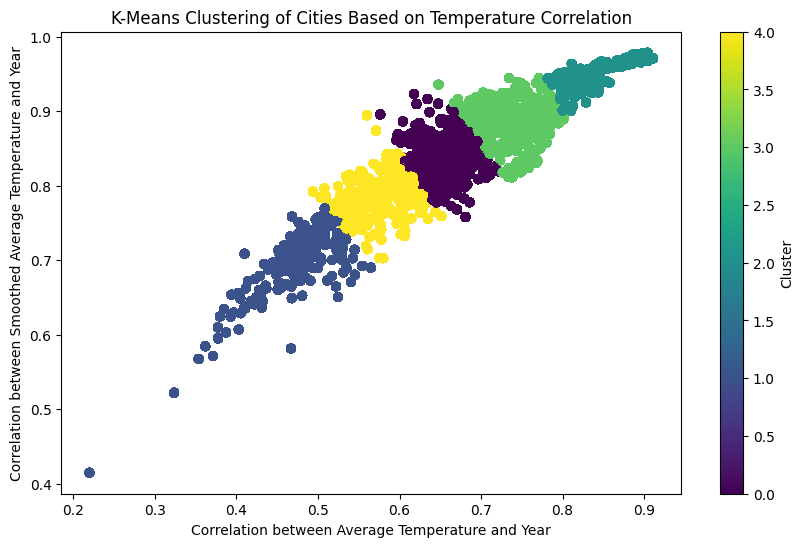

In [18]:
from sklearn.cluster import KMeans
import numpy as np

# Prepare the features for clustering
X = df[['corr', 'smoothed_corr']].dropna()

# Perform K-Means clustering
kmeans = KMeans(n_clusters=5, random_state=42)
df['Cluster'] = kmeans.fit_predict(X)

# Visualize the clusters
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.scatter(df['corr'], df['smoothed_corr'], c=df['Cluster'], cmap='viridis')
plt.title('K-Means Clustering of Cities Based on Temperature Correlation')
plt.xlabel('Correlation between Average Temperature and Year')
plt.ylabel('Correlation between Smoothed Average Temperature and Year')
plt.colorbar(label='Cluster')
plt.show()


In [19]:
# First, calculate the mean correlation for each cluster
cluster_means = df.groupby('Cluster').agg({
    'corr': 'mean',
    'smoothed_corr': 'mean'
}).reset_index().rename(columns={'corr': 'cluster_corr', 'smoothed_corr': 'cluster_corr_smoothed'})

# Then, merge this cluster-level data back into your df_map
# Ensure df_map is prepared as per your previous instructions
df_map = df.groupby(['City', 'Country', 'NumericLatitude', 'NumericLongitude', 'Continent', 'kcc', 'Cluster', 'corr', 'smoothed_corr']).size().reset_index(name='Counts')

# Drop the 'Counts' column, it was only used to facilitate the groupby operation
df_map.drop(columns=['Counts'], inplace=True)

df_map = pd.merge(df_map, cluster_means, on='Cluster', how='left')

In [20]:
import folium

def new_cluster_map(df, cluster_column, map_title):
    # Assuming 'cluster_corr' is already calculated and available in the dataframe
    # Create a base map
    cluster_map = folium.Map(location=[0, 0], zoom_start=2)

    # Define a color palette
    colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 
              'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 
              'darkpurple', 'white', 'pink', 'lightblue', 'lightgreen', 
              'gray', 'black', 'lightgray']

    # Iterate through the DataFrame and add each city as a point on the map
    for _, row in df.iterrows():
        # Updated popup_message to include local_corr and cluster_corr
        popup_message = folium.Popup(
            (f"{row['City']}, {row['Country']}" +
             f"\nLat, Long: {row['NumericLatitude']}, {row['NumericLongitude']}" +
             f"\nKCC: {row['kcc']}" +
             f"\nLocal Corr: {row['corr']:.2f}, Cluster Corr: {row['cluster_corr_smoothed']:.2f}"  # Assuming 'corr' is your local_corr and 'cluster_corr' is already in your dataframe
             ), parse_html=True)
        
        # Create a marker with the popup
        folium.CircleMarker(
            location=[row['NumericLatitude'], row['NumericLongitude']],
            radius=5,
            color=colors[int(row[cluster_column]) % len(colors)],
            fill=True,
            fill_color=colors[int(row[cluster_column]) % len(colors)],
            fill_opacity=0.7,
            popup=popup_message
        ).add_to(cluster_map)
    
    # Save the map as an HTML file
    cluster_map.save(f"{map_title}.html")
    
    return cluster_map


In [21]:
map_title = "Nu_Clusters"
cluster_column = "Cluster"
cluster_map = new_cluster_map(df_map, cluster_column, map_title)

cluster_map
